# London Real Estate Pricing Analysis

## Introduction
In this project I have scraped data from various data about London real estate price and its Boroughs.Then I used Foursquare API to get the common venues of the boroughs.Then using K-means clustering I clustered London Neighborhoods on the basis of the common venues.

# Importing Libraries

In [3]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

import geocoder as geocoder
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

print('Libraries imported.')

Libraries imported.


# Scraping table from Wikipedia

In [14]:
import pandas as pd
import wikipedia as wp
 
#Get the html source
html = wp.page("List of areas of London").html().encode("UTF-8")
df = pd.read_html(html)[1]
df.head()

,Location,London borough,Post town,Postcode district,Dial code,OS grid ref
0,Abbey Wood,"Bexley, Greenwich [7]",LONDON,SE2,020,TQ465785
1,Acton,"Ealing, Hammersmith and Fulham[8]",LONDON,"W3, W4",020,TQ205805
2,Addington,Croydon[8],CROYDON,CR0,020,TQ375645
3,Addiscombe,Croydon[8],CROYDON,CR0,020,TQ345665
4,Albany Park,Bexley,"BEXLEY, SIDCUP","DA5, DA14",020,TQ478728


In [15]:
df.columns

Index(['Location', 'London borough', 'Post town', 'Postcode district',
       'Dial code', 'OS grid ref'],
      dtype='object')

In [16]:
df.columns = ['Location','London_borough','Post town','Postcode district','Dial Code','OS grid ref']

## Cleaning the table

The table contains hyperlinks numbers and there are more than one Postal codes so I decided to keep one.

In [17]:
df['London_borough'] =  df['London_borough'].apply(lambda x: x.replace('[','').replace(']','')) 
df['London_borough'] =  df['London_borough'].str.replace('\d+', '')
df['London_borough'] =  df['London_borough'].str.split(',').str[0]
df['Postcode district'] =  df['Postcode district'].str.split(',').str[0]
df['Postcode district'] =  df['Postcode district'].str.split('(').str[0]
df['Post town'] =  df['Post town'].str.split(',').str[0]

C:\Users\KEVALP~1\AppData\Local\Temp/ipykernel_30524/1178698707.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df['London_borough'] =  df['London_borough'].str.replace('\d+', '')


In [18]:
df.head()

,Location,London_borough,Post town,Postcode district,Dial Code,OS grid ref
0,Abbey Wood,Bexley,LONDON,SE2,020,TQ465785
1,Acton,Ealing,LONDON,W3,020,TQ205805
2,Addington,Croydon,CROYDON,CR0,020,TQ375645
3,Addiscombe,Croydon,CROYDON,CR0,020,TQ345665
4,Albany Park,Bexley,BEXLEY,DA5,020,TQ478728


In [19]:
df.to_csv('london.csv',index=False)

In [20]:
df.shape

(532, 6)

# Getting property data of London
 
This time it was not a wikipedia page so I use pandas read_html function to scrape data.

In [22]:
from urllib.request import Request, urlopen

req = Request(
    url='https://propertydata.co.uk/cities/london', 
    headers={'User-Agent': 'Mozilla/5.0'}
)
webpage = urlopen(req).read()

In [26]:
url = 'https://propertydata.co.uk/cities/london'
response = requests.get(url)

In [27]:
from bs4 import BeautifulSoup

soup = BeautifulSoup(response.text, 'html.parser')

In [28]:
table = soup.find('table')

In [29]:
data = []

for row in table.find_all('tr'):
    cols = row.find_all('td')
    cols = [ele.text.strip() for ele in cols]
    data.append([ele for ele in cols if ele])

df2 = pd.DataFrame(data)

In [34]:
df2.rename(columns = {0:"Postcode district",1:"Avg asking price",2:"Avg rental yeild",3:"Sales per month",4:"Avg sold £/sqft",5:"Explore more"}, inplace = True)
df2.drop(0,axis = 0,inplace=True)

In [35]:
#tables = pd.read_html("https://propertydata.co.uk/cities/london",header={'User-Agent': 'Mozilla/5.0'})
#df2=pd.DataFrame(data=tables[0])
#df2
df2

,Postcode district,Avg asking price,Avg rental yeild,Sales per month,Avg sold £/sqft,Explore more
1,BR1,"£502,800",4.3%,31,£491,Trend\n Explore
2,BR2,"£600,465",3.8%,31,£512,Trend\n Explore
3,BR3,"£579,566",3.5%,35,£531,Trend\n Explore
4,BR4,"£702,091",-,8,£512,Trend\n Explore
5,BR5,"£475,560",4.5%,32,£475,Trend\n Explore
6,BR6,"£607,761",3.8%,28,£513,Trend\n Explore
7,BR7,"£654,305",3.9%,13,£545,Trend\n Explore
8,BR8,"£425,051",-,15,£407,Trend\n Explore
9,CR0,"£382,585",5.1%,76,£442,Trend\n Explore
10,CR2,"£516,306",3.7%,30,£469,Trend\n Explore


In [33]:
df2.columns

Index(['Postcode district', 'Avg asking price', 'Avg rental yeild',
       'Sales per month', 'Avg sold £/sqft', 'Explore more'],
      dtype='object')

# Cleaning Property Data

Firstly removed unwanted columns then price was in string format so '£' and commas to be removed

In [39]:
df2.drop(columns=['Avg rental yeild','Sales per month','Avg sold £/sqft','Explore more'], axis =1,inplace=True)

In [43]:
df2.rename(columns = {"Postcode district":"Area", "Avg asking price":"Avg price"}, inplace = True)


In [45]:
df2.head()

,Area,Avg price
1,BR1,"£502,800"
2,BR2,"£600,465"
3,BR3,"£579,566"
4,BR4,"£702,091"
5,BR5,"£475,560"


In [46]:
df2['Avg price'] = df2['Avg price'].str.replace("£","")
df2['Avg price'] = df2['Avg price'].str.replace(',', '')
df2['Avg price'] = pd.to_numeric(df2['Avg price'])

In [47]:
df2.head()

,Area,Avg price
1,BR1,502800
2,BR2,600465
3,BR3,579566
4,BR4,702091
5,BR5,475560


In [48]:
df2.columns=['Postcode district','Avg price']

In [49]:
df2.to_csv('london_postcode.csv',index=False)

# Merge the table of London Boroughs and London House Prices

I have done inner joint because there were many postcodes that were not in the London Borough's table

In [50]:
data=pd.merge(df, df2, how='inner', left_on='Postcode district', right_on='Postcode district')

# Finding Longitude and Latitude of the Locations


In [51]:
def getLatLong(row):
    #print('post :{}'.format(row[:]))
    #print('neigh :{}'.format(row[1]))
    # initialize your variable to None
    lat_lng_coords = None
    search_query = '{}, London,UK'.format(row)
    # loop until you get the coordinates
    try:
        while(lat_lng_coords is None):
            #g = geocoder.here(search_query,app_id=app_id,app_code=app_code)
            g = geocoder.arcgis(search_query)
            lat_lng_coords = g.latlng
            #print('FIRST')
    except IndexError:
        latitude = 0.0
        longitude = 0.0
        print('BACKUP')
        return [latitude,longitude]

    latitude = lat_lng_coords[0]
    longitude = lat_lng_coords[1]
    print(latitude, longitude)
    return [latitude, longitude]

In [52]:
coords_list = data['Postcode district'].apply(getLatLong).tolist()

51.499741613000026 0.12406168200004686
51.499741613000026 0.12406168200004686
51.499741613000026 0.12406168200004686
51.521205000000066 -0.27397542799997154
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.38475500000004 -0.05149847299992416
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.52410000000003 -0.11164999999994052
51.52410000000003 -0.11164999999994052
51.51462500100007 -0.11486033199997792
51.51462500100007 -0.11486033199997792
51.51462500100007 -0.11486033199997792
51.51462500100007 -0.11486033199997792
51.507408360000056 -0.12769869299995662
51.507408360000056

51.573064620453266 0.1482251074934301
51.48512614800006 0.029115000000047075
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.507408360000056 -0.12769869299995662
51.50227000000007 -0.07645711499992558
51.50227000000007 -0.07645711499992558
51.50227000000007 -0.07645711499992558
51.50227000000007 -0.07645711499992558
51.646807539000065 0.0027100000000359614
51.646807539000065 0.0027100000000359614
51.41019000000006 0.06079682400002184
51.4101

51.43677000000008 -0.2570562169999562
51.507408360000056 -0.12769869299995662
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.53712499900007 -0.18195847999993475
51.53712499900007 -0.18195847999993475
51.51445617600007 -0.058209999999974116
51.51445617600007 -0.058209999999974116
51.528185000000065 -0.1850802839999801
51.528185000000065 -0.1850802839999801
51.392200176000074 -0.21594999899997447
51.392200176000074 -0.21594999899997447
51.392200176000074 -0.21594999899997447
51.392200176000074 -0.21594999899997447
51.52080500000005 -0.06353187499996693
51.52080500000005 -0.06353187499996693
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.513509999000064 -0.047456706999980725
51.40262500000006 -0.14363752499997418
51.393815000000075 -0.24302518199993983


## Merging the values in the dataframe

In [53]:
data[['Latitude','Longitude']]=pd.DataFrame(coords_list,columns=['Latitude', 'Longitude'])
data.head()

,Location,London_borough,Post town,Postcode district,Dial Code,OS grid ref,Avg price,Latitude,Longitude
0,Abbey Wood,Bexley,LONDON,SE2,020,TQ465785,409224,51.499742,0.124062
1,Crossness,Bexley,LONDON,SE2,020,TQ480800,409224,51.499742,0.124062
2,West Heath,Bexley,LONDON,SE2,020,TQ475775,409224,51.499742,0.124062
3,Acton,Ealing,LONDON,W3,020,TQ205805,518722,51.521205,-0.273975
4,Addington,Croydon,CROYDON,CR0,020,TQ375645,382585,51.384755,-0.051498


In [293]:
data

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude
0,Abbey Wood,Bexley,SE2,409224,51.499742,0.124062
1,Crossness,Bexley,SE2,409224,51.499742,0.124062
2,West Heath,Bexley,SE2,409224,51.499742,0.124062
3,Acton,Ealing,W3,518722,51.521205,-0.273975
4,Addington,Croydon,CR0,382585,51.384755,-0.051498
5,Addiscombe,Croydon,CR0,382585,51.384755,-0.051498
6,Coombe,Croydon,CR0,382585,51.384755,-0.051498
7,Croydon,Croydon,CR0,382585,51.384755,-0.051498
8,Forestdale,Croydon,CR0,382585,51.384755,-0.051498
9,New Addington,Croydon,CR0,382585,51.384755,-0.051498


## Droping unwanted columns

In [54]:
data.drop(columns=['Post town','Dial Code','OS grid ref'],inplace=True)

#### Use geopy library to get the latitude and longitude values of London.

In [55]:
address = 'London'

geolocator = Nominatim(user_agent="ldn_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of London are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of London are 51.5073359, -0.12765.


## Create a map of London with neighborhoods superimposed on top.

In [56]:
map_london = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood in zip(data['Latitude'], data['Longitude'], data['London_borough'], data['Location']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_london)  
    
map_london

Next, utilizing the Foursquare API to explore the neighborhoods and segment them.

## Define Foursquare Credentials and Version

In [120]:
CLIENT_ID = 'U0OWUYRP10WK5UFHIVQGDEKRQLZBSFYRALYTWAF0OBVJHIZ4' # your Foursquare ID
CLIENT_SECRET = 'R2BLV2WI204CLFJ5GTAS1OR0U2AFMKZV5UTWI20OREP30SZQ' # your Foursquare Secret
VERSION = '20180604'
#CLIENT_ID = 'SHP50I1LL2EPD4E31W2ZK3KXPCPUJHCO3UGX0V4DUAO3TIGY' # your Foursquare ID
#CLIENT_SECRET = 'D4J2J1PGYEYVOX0YRRHZ250EHDQZRKVYS30DSXZDVX5D1HU5' # your Foursquare Secret
#VERSION = '20210605'

In [121]:
def getBuiltUrl(neigh_lat,neigh_long,radius=1400):
    # type your answer here
    LIMIT=100
    #radius=1000
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neigh_lat, 
    neigh_long, 
    radius, 
    LIMIT)
    return url

## Exploring first Location in our dataframe

In [149]:
neigh_name, neigh_borough, neigh_post, neigh_price, neigh_lat, neigh_long = data.iloc[0]
print('Latitude and longitude values of {} are {}, {}.'.format(neigh_name, 
                                                               neigh_lat, 
                                                               neigh_long))
results = requests.get(getBuiltUrl(neigh_lat,neigh_long))
print(results)
results = results.json()
print(results)

Latitude and longitude values of Abbey Wood are 51.499741613000026, 0.12406168200004686.
<Response [200]>
{'meta': {'code': 200, 'requestId': '64f7ab4708c0611256b2450a'}, 'response': {'venues': [{'id': '63d1585c7bced4695b043bff', 'name': 'Greenwich Dance At The Nest', 'location': {'address': 'Cygnet Square', 'lat': 51.497955, 'lng': 0.12379836, 'labeledLatLngs': [{'label': 'display', 'lat': 51.497955, 'lng': 0.12379836}], 'distance': 199, 'postalCode': 'SE2 9FA', 'cc': 'GB', 'city': 'London', 'state': 'Greater London', 'country': 'United Kingdom', 'formattedAddress': ['Cygnet Square', 'London', 'Greater London', 'SE2 9FA', 'United Kingdom']}, 'categories': [{'id': '4bf58dd8d48988d134941735', 'name': 'Dance Studio', 'pluralName': 'Dance Studios', 'shortName': 'Dance Studio', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_dancestudio_', 'suffix': '.png'}, 'primary': True}], 'createdAt': 1674664028, 'referralId': 'v-1693952839', 'hasPerk': Fal

In [295]:
results['response']['venues']

[{'id': '63d1585c7bced4695b043bff',
  'name': 'Greenwich Dance At The Nest',
  'location': {'address': 'Cygnet Square',
   'lat': 51.497955,
   'lng': 0.12379836,
   'labeledLatLngs': [{'label': 'display',
     'lat': 51.497955,
     'lng': 0.12379836}],
   'distance': 199,
   'postalCode': 'SE2 9FA',
   'cc': 'GB',
   'city': 'London',
   'state': 'Greater London',
   'country': 'United Kingdom',
   'formattedAddress': ['Cygnet Square',
    'London',
    'Greater London',
    'SE2 9FA',
    'United Kingdom']},
  'categories': [{'id': '4bf58dd8d48988d134941735',
    'name': 'Dance Studio',
    'pluralName': 'Dance Studios',
    'shortName': 'Dance Studio',
    'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/arts_entertainment/performingarts_dancestudio_',
     'suffix': '.png'},
    'primary': True}],
  'createdAt': 1674664028,
  'referralId': 'v-1693952839',
  'hasPerk': False},
 {'id': '4e269f1ffa7682ed2302d95b',
  'name': 'Pickford Lane',
  'location': {'lat': 51.50285113

In [138]:
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [296]:
venues = results["response"]["venues"]
nearby_venues = pd.json_normalize(venues) # flatten JSON
nearby_venues

,id,name,categories,createdAt,referralId,hasPerk,location.address,location.lat,location.lng,location.labeledLatLngs,location.distance,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,venuePage.id,location.crossStreet,location.neighborhood
0,63d1585c7bced4695b043bff,Greenwich Dance At The Nest,"[{'id': '4bf58dd8d48988d134941735', 'name': 'D...",1674664028,v-1693952839,False,Cygnet Square,51.497955,0.123798,"[{'label': 'display', 'lat': 51.497955, 'lng':...",199,SE2 9FA,GB,London,Greater London,United Kingdom,"[Cygnet Square, London, Greater London, SE2 9F...",NaN,NaN,NaN
1,4e269f1ffa7682ed2302d95b,Pickford Lane,"[{'id': '4d4b7105d754a06375d81259', 'name': 'B...",1311153951,v-1693952839,False,NaN,51.502851,0.122406,"[{'label': 'display', 'lat': 51.50285113960903...",364,NaN,GB,Greater London,Greater London,United Kingdom,"[Greater London, United Kingdom]",NaN,NaN,NaN
2,4e4a430e1850545dfc0289ae,Southmere Lake,"[{'id': '4bf58dd8d48988d161941735', 'name': 'L...",1313489678,v-1693952839,False,Binsey Walk,51.500381,0.125012,"[{'label': 'display', 'lat': 51.50038136629462...",97,SE2 9TU,GB,London,Greater London,United Kingdom,"[Binsey Walk, London, Greater London, SE2 9TU,...",NaN,NaN,NaN
3,4d60067c9f67f04d40be73fb,BP,"[{'id': '4bf58dd8d48988d113951735', 'name': 'F...",1298138748,v-1693952839,False,84-89 Harrow Manorway,51.492929,0.121520,"[{'label': 'display', 'lat': 51.49292885, 'lng...",778,SE2 9SA,GB,London,Greater London,United Kingdom,"[84-89 Harrow Manorway, London, Greater London...",583660578,NaN,NaN
4,4faf8eafe4b091b46318c9ae,Automech S.E,"[{'id': '52f2ab2ebcbc57f1066b8b44', 'name': 'A...",1336905391,v-1693952839,False,6 Sedgemere Road,51.493402,0.118700,"[{'label': 'display', 'lat': 51.49340243004802...",797,NaN,GB,NaN,NaN,United Kingdom,"[6 Sedgemere Road, United Kingdom]",NaN,NaN,NaN
5,4ad07ccaf964a52036d820e3,Spelthorne Gym,[],1255177418,v-1693952839,False,College Road,51.490541,0.134371,"[{'label': 'display', 'lat': 51.490541, 'lng':...",1248,NaN,GB,Londpn,NaN,United Kingdom,"[College Road, Londpn, United Kingdom]",NaN,NaN,NaN
6,54aad2db498eae35a316829e,The Link,"[{'id': '4bf58dd8d48988d16d941735', 'name': 'C...",1420481243,v-1693952839,False,Belvedere Road,51.500649,0.121686,"[{'label': 'display', 'lat': 51.50064851757535...",193,SE2 9BS,GB,Greater London,Greater London,United Kingdom,"[Belvedere Road (Harrow Manor Way), Greater Lo...",NaN,Harrow Manor Way,NaN
7,ce2b910c0cfc409f0ff1f4bf,"London, United Kingdom",[],1569974400,v-1693952839,False,28 Longworth Close,51.509085,0.130511,"[{'label': 'display', 'lat': 51.509085, 'lng':...",1132,SE28 8PE,GB,London,Greater London,United Kingdom,"[28 Longworth Close, London, Greater London, S...",NaN,NaN,NaN
8,4b142152f964a520be9d23e3,Abbey Wood Railway Station (ABW),"[{'id': '4bf58dd8d48988d129951735', 'name': 'R...",1259610450,v-1693952839,False,Wilton Rd,51.491097,0.121334,"[{'label': 'display', 'lat': 51.49109702149618...",980,SE2 9RH,GB,Abbey Wood,Greater London,United Kingdom,"[Wilton Rd (Felixstowe Rd), Abbey Wood, Greate...",NaN,Felixstowe Rd,NaN
9,4df48176d1649c8a28e6c387,Londis,"[{'id': '4d954b0ea243a5684a65b473', 'name': 'C...",1307869558,v-1693952839,False,84-89 Harrow Manorway,51.492958,0.121756,"[{'label': 'display', 'lat': 51.49295789443129...",771,SE2 9SA,GB,Abbey Wood,Greater London,United Kingdom,"[84-89 Harrow Manorway, Abbey Wood, Greater Lo...",NaN,NaN,NaN


#### Now cleaning the json file and structure it into a *pandas* dataframe.

In [299]:
venues = results["response"]["venues"]
nearby_venues = pd.json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['name', 'categories', 'location.lat', 'location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

,name,categories,lat,lng
0,Greenwich Dance At The Nest,Dance Studio,51.497955,0.123798
1,Pickford Lane,Business and Professional Services,51.502851,0.122406
2,Southmere Lake,Lake,51.500381,0.125012
3,BP,Fuel Station,51.492929,0.121520
4,Automech S.E,Automotive Repair Shop,51.493402,0.118700


In [300]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

50 venues were returned by Foursquare.


# Function to repeat the same process to all the neighborhoods in London

In [304]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        LIMIT=100
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

#### Running our function for all Location in the dataframe

In [305]:
london_venues = getNearbyVenues(names=data['Location'], 
                                   latitudes=data['Latitude'], 
                                   longitudes=data['Longitude'], 
                                   radius=500)

Abbey Wood
Crossness
West Heath
Acton
Addington
Addiscombe
Coombe
Croydon
Forestdale
New Addington
Shirley
Waddon
Woodside
Albany Park
Bexley (also Old Bexley, Bexley Village)
Aldborough Hatch
Gants Hill
Newbury Park
Aldgate
Tower Hill
Aldwych
Charing Cross
Covent Garden
St Giles
Alperton
Sudbury
Wembley
Anerley
Penge
Angel
Barbican
Clerkenwell
Farringdon
Finsbury
St Luke's
Aperfield
Biggin Hill
Archway
Upper Holloway
Ardleigh Green
Emerson Park
Hornchurch
Arkley
Barnet (also Chipping Barnet, High Barnet)
Monken Hadley
Arnos Grove
Bounds Green
Brunswick Park
Colney Hatch
Friern Barnet
New Southgate
Balham
Bankside
Bermondsey
Elephant and Castle
Lambeth
Newington
Barking
Creekmouth
Barkingside
Barnehurst
Barnes
Castelnau
Barnes Cray
Crayford
Barnet Gate
The Hale
Mill Hill
Barnsbury
Canonbury
De Beauvoir Town
Hoxton
Islington
Pentonville
Shoreditch
Battersea
Bayswater
Paddington
Beckenham
Bickley
Bromley Common
Eden Park
Elmers End
Beckton
East Ham
Upton Park
Becontree
Castle Green
Dagen

In [306]:
print(london_venues.shape)
london_venues.head()

(22373, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbey Wood,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
1,Crossness,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
2,West Heath,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
3,Acton,51.521205,-0.273975,Oxygen Freejumping,51.521545,-0.277128,Recreation Center
4,Acton,51.521205,-0.273975,LH2 Studios,51.524233,-0.276564,Music Venue


In [307]:
london_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbey Wood,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
1,Crossness,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
2,West Heath,51.499742,0.124062,Southmere Lake,51.500381,0.125012,Lake
3,Acton,51.521205,-0.273975,Oxygen Freejumping,51.521545,-0.277128,Recreation Center
4,Acton,51.521205,-0.273975,LH2 Studios,51.524233,-0.276564,Music Venue


### Venues returned for each Neighborhood Location

In [308]:
london_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbey Wood,1,1,1,1,1,1
Acton,6,6,6,6,6,6
Addington,2,2,2,2,2,2
Addiscombe,2,2,2,2,2,2
Albany Park,100,100,100,100,100,100
Aldborough Hatch,100,100,100,100,100,100
Aldgate,73,73,73,73,73,73
Aldwych,100,100,100,100,100,100
Alperton,100,100,100,100,100,100


In [309]:
print('There are {} uniques categories.'.format(len(london_venues['Venue Category'].unique())))

There are 297 uniques categories.


## Analyzing each Neighborhood Location

In [310]:
# one hot encoding
london_onehot = pd.get_dummies(london_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
london_onehot['Neighborhood'] = london_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [london_onehot.columns[-1]] + list(london_onehot.columns[:-1])
london_onehot = london_onehot[fixed_columns]

london_onehot.head()

,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Gym and Studio,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Movie Theater,Museum,Music Store,Music Venue,Neighborhood,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and Recreation,Stable,Steakhouse,Street Art,Street Food Gathering,Structure,Supermarket,Sushi Restaurant,Szechuan Restaurant,Tap

In [311]:
london_onehot.shape

(22373, 297)

###  Grouping rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [312]:
london_grouped = london_onehot.groupby('Neighborhood').mean().reset_index()
london_grouped

,Neighborhood,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Gym and Studio,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Movie Theater,Museum,Music Store,Music Venue,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and Recreation,Stable,Steakhouse,Street Art,Street Food Gathering,Structure,Supermarket,Sushi Restaurant,Szechuan Restaurant,Tap

In [313]:
a=london_grouped
a.head()

,Neighborhood,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Gym and Studio,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Movie Theater,Museum,Music Store,Music Venue,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and Recreation,Stable,Steakhouse,Street Art,Street Food Gathering,Structure,Supermarket,Sushi Restaurant,Szechuan Restaurant,Tap

### Top 5 most common venues for each Neighborhood

In [314]:
num_top_venues = 5

for hood in a['Neighborhood']:
    print("----"+hood+"----")
    temp = a[a['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Abbey Wood----
                     venue  freq
0                     Lake   1.0
1   Okonomiyaki Restaurant   0.0
2      Office Supply Store   0.0
3  North Indian Restaurant   0.0
4        Noodle Restaurant   0.0


----Acton----
                 venue  freq
0          Music Venue  0.17
1       Hardware Store  0.17
2                 Café  0.17
3                 Park  0.17
4  Rental Car Location  0.17


----Addington----
                     venue  freq
0              Art Gallery   0.5
1            Grocery Store   0.5
2              Music Store   0.0
3  North Indian Restaurant   0.0
4        Noodle Restaurant   0.0


----Addiscombe----
                     venue  freq
0              Art Gallery   0.5
1            Grocery Store   0.5
2              Music Store   0.0
3  North Indian Restaurant   0.0
4        Noodle Restaurant   0.0


----Albany Park----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant 

             venue  freq
0              Pub  0.11
1      Coffee Shop  0.06
2         Pizzeria  0.05
3  Thai Restaurant  0.04
4           Market  0.04


----Canonbury----
             venue  freq
0              Pub  0.15
1         Bus Stop  0.06
2              Bar  0.04
3  Thai Restaurant  0.04
4             Café  0.04


----Carshalton----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Castelnau----
            venue  freq
0             Pub  0.11
1     Coffee Shop  0.07
2        Pizzeria  0.07
3   Grocery Store  0.07
4  Farmers Market  0.07


----Castle Green----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Catford----
               venue  freq
0      Grocery Store  0.17
1       Betting Shop  0.17
2  Convenience Store  0.17
3         

                 venue  freq
0                Hotel  0.25
1                 Café  0.19
2  Fish and Chips Shop  0.12
3            Reservoir  0.12
4           Bagel Shop  0.06


----Fitzrovia----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Foots Cray----
                venue  freq
0  Chinese Restaurant  0.25
1   Convenience Store  0.25
2                 Pub  0.25
3            Bus Stop  0.25
4              Winery  0.00


----Forest Gate----
          venue  freq
0           Pub  0.33
1          Café  0.33
2           Bar  0.17
3  Flower Store  0.17
4        Winery  0.00


----Forest Hill----
                venue  freq
0                Café  0.23
1   Indian Restaurant  0.08
2  Italian Restaurant  0.08
3          Gift Store  0.08
4       Sandwich Spot  0.08


----Forestdale----
                     venue  freq
0              Art Gallery   0.5
1            Groce

4  Italian Restaurant  0.05


----Kensington----
                venue  freq
0                Café  0.10
1  Italian Restaurant  0.06
2         Coffee Shop  0.06
3            Boutique  0.04
4  Chinese Restaurant  0.04


----Kentish Town----
                venue  freq
0                 Pub  0.12
1  Italian Restaurant  0.12
2                Café  0.12
3            Platform  0.06
4   Convenience Store  0.06


----Kenton----
                 venue  freq
0    Indian Restaurant  0.33
1             Boutique  0.17
2    Electronics Store  0.17
3  Fish and Chips Shop  0.17
4   Turkish Restaurant  0.17


----Keston----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Kew----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Kidbrooke----
              

      venue  freq
0     Hotel  0.12
1       Pub  0.08
2    Bakery  0.08
3  Pizzeria  0.06
4      Park  0.06


----Millwall----
                 venue  freq
0        Grocery Store  0.10
1                  Pub  0.10
2         Dessert Shop  0.05
3                 Park  0.05
4  Fried Chicken Joint  0.05


----Mitcham----
                     venue  freq
0        Convenience Store  0.33
1                 Bus Stop  0.33
2     Fast Food Restaurant  0.33
3                   Winery  0.00
4  New American Restaurant  0.00


----Monken Hadley----
                 venue  freq
0          Coffee Shop  0.33
1               Retail  0.33
2                 Café  0.33
3          Music Venue  0.00
4  Office Supply Store  0.00


----Morden----
                     venue  freq
0            Grocery Store  0.25
1            Garden Center  0.25
2                      Pub  0.25
3                     Café  0.25
4  North Indian Restaurant  0.00


----Morden Park----
                     venue  freq
0            Gr

4                 Pub  0.03


----Richmond----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Riddlesdown----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Roehampton----
                    venue  freq
0  Landmarks and Outdoors  0.25
1                  Stable  0.25
2      Italian Restaurant  0.25
3           Grocery Store  0.25
4             Music Venue  0.00


----Romford----
                      venue  freq
0  Furniture and Home Store   1.0
1                    Winery   0.0
2               Music Store   0.0
3   North Indian Restaurant   0.0
4         Noodle Restaurant   0.0


----Rotherhithe----
              venue  freq
0               Pub  0.07
1          Pizzeria  0.07
2              Park  0.05
3      Fuel Station  0.05
4  Ice C

                venue  freq
0            Bus Stop  0.14
1         Supermarket  0.14
2   Convenience Store  0.14
3  Chinese Restaurant  0.07
4                 Pub  0.07


----Thornton Heath----
                        venue  freq
0           Indian Restaurant  0.25
1    Furniture and Home Store  0.25
2                Betting Shop  0.25
3               Grocery Store  0.25
4  Modern European Restaurant  0.00


----Tokyngton----
                       venue  freq
0  Middle Eastern Restaurant  0.25
1                        Pub  0.25
2       Fast Food Restaurant  0.25
3                Coffee Shop  0.25
4                   Monument  0.00


----Tolworth----
                venue  freq
0             Theater  0.12
1               Hotel  0.09
2               Plaza  0.04
3  Italian Restaurant  0.04
4                 Pub  0.03


----Tooting----
                venue  freq
0     Cosmetics Store  0.14
1  Pet Supplies Store  0.14
2      Shopping Plaza  0.14
3         Supermarket  0.14
4        Carpet 

## Put in the Dataframe

In [315]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

#### Create the new dataframe and display the top 10 venues for each neighborhood.

In [316]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = a['Neighborhood']

for ind in np.arange(a.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(a.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
1,Acton,Music Venue,Hardware Store,Café,Park,Rental Car Location,Recreation Center,New American Restaurant,North Indian Restaurant,Noodle Restaurant,Night Club
2,Addington,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
3,Addiscombe,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
4,Albany Park,Theater,Hotel,Plaza,Italian Restaurant,Pub,Monument,Steakhouse,Art Gallery,Garden,Cocktail Bar


In [317]:
neighborhoods_venues_sorted.rename(columns = {'Neighborhood':'Location'}, inplace = True)

## Adding Average house price of each Neighborhood in the Group
### Normalizing the Avg price column

In [318]:
a['Price']=data['Avg price']
v= a.iloc[:, -1]
a.iloc[:,-1] = (v - v.min()) / (v.max() - v.min())

In [351]:
a

,Neighborhood,Winery,Adult Store,African Restaurant,American Restaurant,Antique Store,Apartment or Condo,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts and Crafts Store,Arts and Entertainment,Asian Restaurant,Attraction,Auction House,Australian Restaurant,Austrian Restaurant,Automotive Repair Shop,BBQ Joint,Bagel Shop,Bakery,Bar,Bathing Area,Beach,Bed and Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bicycle Store,Bike Rental,Bistro,Boarding House,Boat or Ferry,Bookstore,Boutique,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Burger Joint,Burrito Restaurant,Bus Station,Bus Stop,Café,Camera Store,Campground,Canal,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Carpet Store,Casino,Caucasian Restaurant,Cave,Chaat Place,Champagne Bar,Cheese Store,Chinese Restaurant,Chocolate Store,Church,Circus School,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Quad,Comedy Club,Comic Book Store,Concert Hall,Convenience Store,Convention Center,Cosmetics Store,Costume Store,Creperie,Cupcake Shop,Dance Studio,Deli,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distillery,Dive Bar,Donut Shop,Dumpling Restaurant,Education,Electronics Store,Empanada Restaurant,English Restaurant,Escape Room,Ethiopian Restaurant,Event Space,Exhibit,Falafel Restaurant,Farm,Farmers Market,Fashion Accessories Store,Fast Food Restaurant,Filipino Restaurant,Fish Market,Fish and Chips Shop,Flea Market,Flower Store,Food Court,Food Stand,Food Truck,Food and Beverage Retail,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit and Vegetable Store,Fuel Station,Furniture and Home Store,Gaming Cafe,Garden,Garden Center,Gastropub,Gay Bar,Gelato Shop,Gift Store,Gourmet Store,Greek Restaurant,Grocery Store,Gym and Studio,Hair Salon,Halal Restaurant,Harbor or Marina,Hardware Store,Herbs and Spices Store,Hiking Trail,Hill,Himalayan Restaurant,Historic and Protected Site,History Museum,Hobby Store,Hookah Bar,Hostel,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Hunan Restaurant,Ice Cream Parlor,Imported Food Store,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Internet Cafe,Iraqi Restaurant,Irish Pub,Israeli Restaurant,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jazz and Blues Venue,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Landmarks and Outdoors,Laser Tag Center,Latin American Restaurant,Law School,Lebanese Restaurant,Library,Light Rail Station,Liquor Store,Lounge,Mac and Cheese Joint,Malay Restaurant,Mamak Restaurant,Market,Mediterranean Restaurant,Memorial Site,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf Course,Miscellaneous Store,Mobile Phone Store,Modern European Restaurant,Monument,Moroccan Restaurant,Movie Theater,Museum,Music Store,Music Venue,New American Restaurant,Newsagent,Night Club,Noodle Restaurant,North Indian Restaurant,Office Supply Store,Okonomiyaki Restaurant,Organic Grocery,Outdoor Event Space,Outdoor Sculpture,Pakistani Restaurant,Palace,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Store,Persian Restaurant,Peruvian Restaurant,Pet Supplies Store,Pharmacy,Pie Shop,Pier,Pizzeria,Platform,Playground,Plaza,Polish Restaurant,Portuguese Restaurant,Print Store,Pub,Public Art,Race Track,Rail Station,Ramen Restaurant,Record Store,Recreation Center,Rental Car Location,Reservoir,Restaurant,Retail,River,Road,Rock Climbing Spot,Rock Club,Russian Restaurant,Salad Restaurant,Sandwich Spot,Scandinavian Restaurant,Scenic Lookout,Science Museum,Seafood Restaurant,Shaanxi Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Soccer Stadium,Social Club,South American Restaurant,Souvenir Store,Souvlaki Shop,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Retail,Sports Bar,Sports and Recreation,Stable,Steakhouse,Street Art,Street Food Gathering,Structure,Supermarket,Sushi Restaurant,Szechuan Restaurant,Tap




# Clustering Neighborhoods

running K-means clustering for 4 clusters

In [319]:
kclusters = 6

london_grouped_clustering = a.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(london_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

C:\Users\KEVALP~1\AppData\Local\Temp/ipykernel_30524/3999436609.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  london_grouped_clustering = a.drop('Neighborhood', 1)


array([3, 0, 5, 5, 0, 0, 0, 0, 0, 0])

In [354]:
kmeans.labels_[0:50] 

array([3, 0, 5, 5, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0])

C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:881: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:881: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


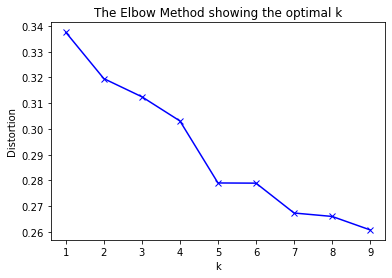

In [320]:
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt

# k means determine k
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(london_grouped_clustering)
    kmeanModel.fit(london_grouped_clustering)
    distortions.append(sum(np.min(cdist(london_grouped_clustering, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / london_grouped_clustering.shape[0])

# Plot the elbow
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()


In [321]:
neighborhoods_venues_sorted.head()

,Location,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
1,Acton,Music Venue,Hardware Store,Café,Park,Rental Car Location,Recreation Center,New American Restaurant,North Indian Restaurant,Noodle Restaurant,Night Club
2,Addington,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
3,Addiscombe,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
4,Albany Park,Theater,Hotel,Plaza,Italian Restaurant,Pub,Monument,Steakhouse,Art Gallery,Garden,Cocktail Bar


#### Create a new dataframe that includes the cluster as well as the top 10 venues for each neighborhood.

In [323]:
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

london_merged = data

london_merged = london_merged.join(neighborhoods_venues_sorted.set_index('Location'), on='Location')

london_merged

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Abbey Wood,Bexley,SE2,409224,51.499742,0.124062,3.0,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
1,Crossness,Bexley,SE2,409224,51.499742,0.124062,3.0,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
2,West Heath,Bexley,SE2,409224,51.499742,0.124062,3.0,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
3,Acton,Ealing,W3,518722,51.521205,-0.273975,0.0,Music Venue,Hardware Store,Café,Park,Rental Car Location,Recreation Center,New American Restaurant,North Indian Restaurant,Noodle Restaurant,Night Club
4,Addington,Croydon,CR0,382585,51.384755,-0.051498,5.0,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
5,Addiscombe,Croydon,CR0,382585,51.384755,-0.051498,5.0,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
6,Coombe,Croydon,CR0,382585,51.384755,-0.051498,0.0,Café,Pub,Thai Restaurant,Hotel,Burger Joint,Sushi Restaurant,Supermarket,Grocery Store,Bookstore,Public Art
7,Croydon,Croydon,CR0,382585,51.384755,-0.051498,5.0,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
8,Forestdale,Croydon,CR0,382585,51.384755,-0.051498,5.0,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery
9,New Addington,Croydon,CR0,382585,51.384755,-0.051498,5.0,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Night Club,Newsagent,New American Restaurant,Music Venue,Winery


##### There was null value in the merged data so droping the rows with null values

In [324]:
london_merged.dropna(inplace=True)

##### Because of null values the data type of 'Cluster Labels' was changed from int to float so converting it back to int

In [325]:
london_merged['Cluster Labels'] = london_merged['Cluster Labels'].astype(int)
london_merged.dtypes

Location                   object
London_borough             object
Postcode district          object
Avg price                   int64
Latitude                  float64
Longitude                 float64
Cluster Labels              int32
1st Most Common Venue      object
2nd Most Common Venue      object
3rd Most Common Venue      object
4th Most Common Venue      object
5th Most Common Venue      object
6th Most Common Venue      object
7th Most Common Venue      object
8th Most Common Venue      object
9th Most Common Venue      object
10th Most Common Venue     object
dtype: object

### There were many Location that were assigned the same postcodes as they were very near so droping the duplicate postcodes 

In [326]:
london_merged.drop_duplicates(subset='Postcode district',inplace=True)

In [327]:
london_merged.reset_index(inplace=True)
london_merged.drop(columns='index',inplace=True)

## Visualize the clusters

In [328]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

# Binning

### There is the range of Avg price so binned the price into 7 distinct values
##### ('Low level 1', 'Low level 2', 'Average level 1', 'Average level 2','Above Average','High level 1','High level 2')

Visualizing the bins

Text(0.5, 1.0, 'Price bins')

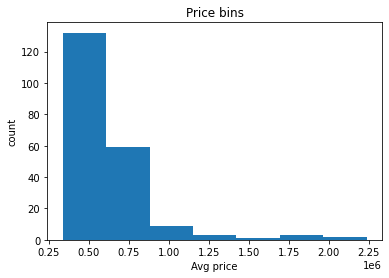

In [329]:
%matplotlib inline
import matplotlib as plt
from matplotlib import pyplot
plt.pyplot.hist(london_merged["Avg price"],bins=7)

# set x/y labels and plot title
plt.pyplot.xlabel("Avg price")
plt.pyplot.ylabel("count")
plt.pyplot.title("Price bins")

In [330]:
bins = np.linspace(min(london_merged["Avg price"]), max(london_merged["Avg price"]), 8)
bins

array([ 336444.        ,  608313.85714286,  880183.71428571,
       1152053.57142857, 1423923.42857143, 1695793.28571429,
       1967663.14285714, 2239533.        ])

In [331]:
group_names = ['Low level 1', 'Low level 2', 'Average level 1', 'Average level 2','Above Average','High level 1','High level 2']

In [332]:
london_merged['Price-Categories'] = pd.cut(london_merged['Avg price'], bins, labels=group_names, include_lowest=True )
london_merged[['Avg price','Price-Categories']].head()

,Avg price,Price-Categories
0,409224,Low level 1
1,518722,Low level 1
2,382585,Low level 1
3,565613,Low level 1
4,480930,Low level 1


## Cluster bins
### Creating 4 bins for clusters

Text(0.5, 1.0, 'Cluster Labels')

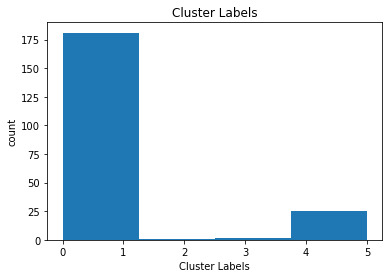

In [333]:
plt.pyplot.hist(london_merged["Cluster Labels"],bins=4)

# set x/y labels and plot title
plt.pyplot.xlabel("Cluster Labels")
plt.pyplot.ylabel("count")
plt.pyplot.title("Cluster Labels")

In [334]:
bins = np.linspace(min(london_merged["Cluster Labels"]), max(london_merged["Cluster Labels"]), 7)
bins

array([0.        , 0.83333333, 1.66666667, 2.5       , 3.33333333,
       4.16666667, 5.        ])

In [335]:
group_names = ['Mixed Social Venues','Hotels and Social Venues','Stores and seafood restaurants','Pubs and Historic places', 'Sports and Athletics','Restaurants and Bars']

In [336]:
london_merged['Cluster-Category'] = pd.cut(london_merged['Cluster Labels'], bins, labels=group_names, include_lowest=True )
london_merged[['Cluster Labels','Cluster-Category']].head()

,Cluster Labels,Cluster-Category
0,3,Pubs and Historic places
1,0,Mixed Social Venues
2,5,Restaurants and Bars
3,0,Mixed Social Venues
4,0,Mixed Social Venues


# Final Data

In [338]:
london_merged.drop(columns=['6th Most Common Venue','7th Most Common Venue','8th Most Common Venue','9th Most Common Venue','10th Most Common Venue'],inplace=True)
london_merged.head(20)

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
0,Abbey Wood,Bexley,SE2,409224,51.499742,0.124062,3,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Pubs and Historic places
1,Acton,Ealing,W3,518722,51.521205,-0.273975,0,Music Venue,Hardware Store,Café,Park,Rental Car Location,Low level 1,Mixed Social Venues
2,Addington,Croydon,CR0,382585,51.384755,-0.051498,5,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Restaurants and Bars
3,Albany Park,Bexley,DA5,565613,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Mixed Social Venues
4,Aldborough Hatch,Redbridge,IG2,480930,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Mixed Social Venues
5,Aldgate,City,EC3,1067294,51.524100,-0.111650,0,Pub,Coffee Shop,Café,Vietnamese Restaurant,Sandwich Spot,Average level 1,Mixed Social Venues
6,Aldwych,Westminster,WC2,1581981,51.514625,-0.114860,0,Coffee Shop,Pub,Theater,Hotel,Sandwich Spot,Above Average,Mixed Social Venues
7,Alperton,Brent,HA0,536137,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Mixed Social Venues
8,Anerley,Bromley,SE20,400248,51.482490,0.119194,0,Campground,Bus Stop,Forest,Modern European Restaurant,Monument,Low level 1,Mixed Social Venues
9,Angel,Islington,EC1,833205,51.530130,-0.107969,0,Coffee Shop,Café,Pub,Food Truck,Vegan and Vegetarian Restaurant,Low level 2,Mixed Social Venues


# Creating Chloropleth map to visualize how London is divided in terms of            Housing prices and cluster markers on the top

In [363]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Avg price'],
    key_on='feature.properties.name',
    fill_color='RdPu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average house Prices'
)
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(lnd_map)
       
# display map
lnd_map

C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\folium\folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [280]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Avg price'],
    key_on='feature.properties.name',
    fill_color='RdPu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average house Prices'
)
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(london_merged['Latitude'],london_merged['Longitude'], london_merged['Location'], london_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=3,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(lnd_map)
       
# display map
lnd_map

# Chloropleth map so to see how the London is clustered 

In [339]:
lnd_geo = r'london_boroughs_proper.geojson'
lnd_map = folium.Map(location = [latitude, longitude], zoom_start = 10)

lnd_map.choropleth(
    geo_data=lnd_geo,
    data=london_merged,
    columns=['London_borough','Cluster Labels'],
    key_on='feature.properties.name',
    fill_color='PuRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Cluster Labels'
)

lnd_map

C:\Users\KEVAL PRAJAPATI\anaconda3\lib\site-packages\folium\folium.py:465: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


# Examining the Clusters

## Cluster 1

In [356]:
london_merged[london_merged['Cluster Labels']==0]
c1_df = london_merged[london_merged['Cluster Labels']==0]
c1_df.to_csv("Cluster_1.csv")

## Cluster 2

In [341]:
london_merged[london_merged['Cluster Labels']==1]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
18,Barkingside,Redbridge,IG6,485379,51.507408,-0.127699,1,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Hotels and Social Venues
19,Barnehurst,Bexley,DA7,466934,51.470520,0.146705,1,Pub,Indian Restaurant,Forest,Convenience Store,Winery,Low level 1,Hotels and Social Venues
20,Barnes,Richmond upon Thames,SW13,1116706,51.472400,-0.244817,1,Pub,Coffee Shop,Pizzeria,Grocery Store,Farmers Market,Average level 1,Hotels and Social Venues
21,Barnes Cray,Bexley,DA1,360895,51.452532,0.168081,1,Chinese Restaurant,Convenience Store,Pub,Bus Stop,Winery,Low level 1,Hotels and Social Venues
74,Clapham,Lambeth,SW4,613987,51.465705,-0.144997,1,Pub,Grocery Store,Coffee Shop,Ice Cream Parlor,Bakery,Low level 2,Hotels and Social Venues
75,Cockfosters,Barnet,EN4,691417,51.640275,-0.157081,1,Coffee Shop,Pub,Park,Café,Pharmacy,Low level 2,Hotels and Social Venues
76,Colindale,Barnet,NW9,461096,51.593619,-0.244623,1,Bus Stop,Supermarket,Convenience Store,Chinese Restaurant,Pub,Low level 1,Hotels and Social Venues
77,Colliers Wood,Merton,SW19,685355,51.419165,-0.189589,1,Café,Bus Stop,Grocery Store,Sushi Restaurant,Chinese Restaurant,Low level 2,Hotels and Social Venues
118,Grange Park,Enfield,N21,738162,51.639875,-0.106919,1,Cosmetics Store,Gastropub,Landmarks and Outdoors,Mobile Phone Store,Modern European Restaurant,Low level 2,Hotels and Social Venues
137,Highbury,Islington,N5,719386,51.553177,-0.103365,1,Soccer Stadium,Café,Coffee Shop,French Restaurant,Food Truck,Low level 2,Hotels and Social Venues


## Cluster 3

In [342]:
london_merged[london_merged['Cluster Labels']==2]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
104,Eltham,Greenwich,SE9,483862,51.433605,0.039919,2,Café,Pet Supplies Store,Museum,North Indian Restaurant,Noodle Restaurant,Low level 1,Stores and seafood restaurants


## Cluster 4

In [343]:
london_merged[london_merged['Cluster Labels']==3]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
0,Abbey Wood,Bexley,SE2,409224,51.499742,0.124062,3,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Pubs and Historic places
124,Ham,Richmond upon Thames,TW10,936982,51.440750,-0.282092,3,Lake,Tree,Park,Office Supply Store,North Indian Restaurant,Average level 1,Pubs and Historic places


## Cluster 5

In [344]:
london_merged[london_merged['Cluster Labels']==4]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
46,Botany Bay,Enfield,EN2,570479,51.653660,-0.110614,4,Flower Store,Pub,Lake,Winery,Music Venue,Low level 1,Sports and Athletics
57,Brondesbury,Brent,NW6,759745,51.533085,-0.195979,4,Pub,Middle Eastern Restaurant,Park,Hotel,Newsagent,Low level 2,Sports and Athletics
64,Chadwell Heath,Redbridge,RM6,435008,51.573065,0.148225,4,Pharmacy,Pub,Hookah Bar,Winery,Music Store,Low level 1,Sports and Athletics
72,Chislehurst,Bromley,BR7,654305,51.410190,0.060797,4,Pub,Cave,Bar,Music Venue,Office Supply Store,Low level 2,Sports and Athletics
84,Cranham,Havering,RM14,601121,51.543071,0.250112,4,Pub,Winery,Museum,North Indian Restaurant,Noodle Restaurant,Low level 1,Sports and Athletics
89,Deptford,Lewisham,SE8,422272,51.485760,-0.029205,4,Pub,Fast Food Restaurant,Harbor or Marina,Vietnamese Restaurant,Park,Low level 1,Sports and Athletics
91,Dulwich,Lambeth,SE21,673566,51.438115,-0.091826,4,Pub,Wine Store,Flower Store,Park,Bakery,Low level 2,Sports and Athletics
94,Earlsfield,Wandsworth,SW18,666276,51.458807,-0.188133,4,Pub,Coffee Shop,Indian Restaurant,Thai Restaurant,Restaurant,Low level 2,Sports and Athletics
96,East Dulwich,Southwark,SE22,651936,51.451360,-0.063569,4,Pub,Café,Park,Indian Restaurant,Convenience Store,Low level 2,Sports and Athletics
97,East Finchley,Barnet,N2,873815,51.583820,-0.169589,4,Pub,Bus Stop,Landmarks and Outdoors,Convenience Store,Park,Low level 2,Sports and Athletics


## Cluster 6

In [345]:
london_merged[london_merged['Cluster Labels']==5]

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
2,Addington,Croydon,CR0,382585,51.384755,-0.051498,5,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Restaurants and Bars


# Examining Property prices

In [359]:
london_merged[london_merged['Price-Categories']=='High level 2']
HL2_df = london_merged[london_merged['Price-Categories']=='High level 2']
HL2_df.to_csv("High_level_2.csv")
london_merged[london_merged['Price-Categories']=='High level 2']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
69,Chinatown,Westminster,W1,2239533,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,High level 2,Mixed Social Venues
148,Kensington,Kensington and Chelsea,SW7,2037330,51.501300,-0.168546,0,Café,Italian Restaurant,Coffee Shop,Boutique,Chinese Restaurant,High level 2,Mixed Social Venues


In [360]:
london_merged[london_merged['Price-Categories']=='High level 1']
HL1_df = london_merged[london_merged['Price-Categories']=='High level 1']
HL1_df.to_csv("High_level_1.csv")
london_merged[london_merged['Price-Categories']=='High level 1']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
32,Belgravia,Westminster,SW1,1703937,51.489360,-0.136190,0,Hotel,Pub,Bakery,Pizzeria,Park,High level 1,Mixed Social Venues
56,Brompton,Kensington and Chelsea,SW3,1942542,51.498105,-0.165170,0,Hotel,Café,Boutique,Italian Restaurant,Japanese Restaurant,High level 1,Mixed Social Venues
140,Holland Park,Kensington and Chelsea,W8,1767872,51.505330,-0.191053,0,Hotel,Pub,Garden,Café,Juice Bar,High level 1,Mixed Social Venues


In [361]:
london_merged[london_merged['Price-Categories']=='Low level 2']
LL2_df = london_merged[london_merged['Price-Categories']=='Low level 2']
LL2_df.to_csv("Low_level_2.csv")
london_merged[london_merged['Price-Categories']=='Low level 2']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
9,Angel,Islington,EC1,833205,51.530130,-0.107969,0,Coffee Shop,Café,Pub,Food Truck,Vegan and Vegetarian Restaurant,Low level 2,Mixed Social Venues
13,Arkley,Barnet,EN5,632666,51.644415,-0.179183,0,Coffee Shop,Retail,Café,Music Venue,Office Supply Store,Low level 2,Mixed Social Venues
15,Balham,Wandsworth,SW12,720615,51.446365,-0.137480,0,Park,Winery,Music Store,North Indian Restaurant,Noodle Restaurant,Low level 2,Mixed Social Venues
16,Bankside,Southwark,SE1,733813,51.500212,-0.115440,0,Hotel,Coffee Shop,Café,Sandwich Spot,Pub,Low level 2,Mixed Social Venues
22,Barnet Gate,Barnet,NW7,675109,51.621413,-0.218125,0,Garden Center,Winery,Okonomiyaki Restaurant,North Indian Restaurant,Noodle Restaurant,Low level 2,Mixed Social Venues
23,Barnsbury,Islington,N1,727676,51.545663,-0.081970,0,Pub,Bus Stop,Bar,Thai Restaurant,Café,Low level 2,Mixed Social Venues
31,Bedford Park,Ealing,W4,862958,51.497765,-0.255852,0,Coffee Shop,Café,Bus Stop,Park,Arts and Crafts Store,Low level 2,Mixed Social Venues
42,Blackfriars,City,EC4,859652,51.515400,-0.104903,0,Pub,Coffee Shop,Italian Restaurant,French Restaurant,Sandwich Spot,Low level 2,Mixed Social Venues
45,Bloomsbury,Camden,WC1,858995,51.517165,-0.126810,0,Theater,Hotel,Coffee Shop,Exhibit,Bakery,Low level 2,Mixed Social Venues
57,Brondesbury,Brent,NW6,759745,51.533085,-0.195979,4,Pub,Middle Eastern Restaurant,Park,Hotel,Newsagent,Low level 2,Sports and Athletics


In [362]:
london_merged[london_merged['Price-Categories']=='Low level 1']
LL1_df = london_merged[london_merged['Price-Categories']=='Low level 1']
LL1_df.to_csv("Low_level_1.csv")
london_merged[london_merged['Price-Categories']=='Low level 1']

,Location,London_borough,Postcode district,Avg price,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Price-Categories,Cluster-Category
0,Abbey Wood,Bexley,SE2,409224,51.499742,0.124062,3,Lake,Okonomiyaki Restaurant,Office Supply Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Pubs and Historic places
1,Acton,Ealing,W3,518722,51.521205,-0.273975,0,Music Venue,Hardware Store,Café,Park,Rental Car Location,Low level 1,Mixed Social Venues
2,Addington,Croydon,CR0,382585,51.384755,-0.051498,5,Art Gallery,Grocery Store,Music Store,North Indian Restaurant,Noodle Restaurant,Low level 1,Restaurants and Bars
3,Albany Park,Bexley,DA5,565613,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Mixed Social Venues
4,Aldborough Hatch,Redbridge,IG2,480930,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Mixed Social Venues
7,Alperton,Brent,HA0,536137,51.507408,-0.127699,0,Theater,Hotel,Plaza,Italian Restaurant,Pub,Low level 1,Mixed Social Venues
8,Anerley,Bromley,SE20,400248,51.482490,0.119194,0,Campground,Bus Stop,Forest,Modern European Restaurant,Monument,Low level 1,Mixed Social Venues
10,Aperfield,Bromley,TN16,568514,51.276121,0.074362,0,Fuel Station,Convenience Store,Veterinarian,Winery,Music Store,Low level 1,Mixed Social Venues
11,Archway,Islington,N19,576419,51.532760,-0.114007,0,Café,Pub,Coffee Shop,Cocktail Bar,Italian Restaurant,Low level 1,Mixed Social Venues
12,Ardleigh Green,Havering,RM11,556114,51.583700,0.174760,0,Bus Station,Furniture and Home Store,Electronics Store,Music Store,Clothing Store,Low level 1,Mixed Social Venues
